![](../Assets/logo.png)
# Machine Learning Model for Identifying Personal Driver Behaviors Using Traffic Violation and Accident History Data


## Problem Statement

We are trying to predict drivers risk score in 2016 based on the violations and accident history data from 2011-2015

## Executive Summary
The dataset was generated and the count and points were randomly assigned to each driver, so there was no significant natural trends to learn from and train on to produce predictions that are highly accurate. Real datasets are needed to build accurate machine learning models that can predict drivers risk score. 

![](../Assets/Dynamic_Driver_profile.jpeg)
### Risk Criteria
![](../Assets/Risk_Criteria.png)

### Contents:
- [Datasets Description](#Datasets_Description)
- [Data Import & Cleaning](#Data_Import_and_Cleaning)
- [Exploratory Data Analysis](#Exploratory_Data_Analysis)
    - [Data Visualization](#Visualize_the_data)
    - [Descriptive and Inferential Statistics](#Descriptive_and_Inferential_Statistics)
- [Preprocessing and Modeling](#Preprocessing_and_Modeling)
- [Conclusions and Recommendations](#Conclusions_and_Recommendations)

<a name="Datasets_Description"></a>
## Datasets Description

Four datasets about drivers, vehicle, violations, and accidents

### List of abbreviations

| Abbreviation     | Meaning |
|------------------|------|
| POY| Part of Year|

<a name="Data_Import_and_Cleaning"></a>
## Data Import & Cleaning

In [114]:
#Basic libraries
import numpy as np
import pandas as pd
from scipy import stats
import random
from random import randint

# Visualization libraries
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
from matplotlib.colors import ListedColormap

# Statistics, EDA, metrics libraries
from scipy.stats import normaltest, skew
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, StandardScaler
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error, accuracy_score, f1_score
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error
from sklearn.metrics import classification_report, confusion_matrix
from scipy.special import boxcox, inv_boxcox


# classification libraries
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, StratifiedKFold, cross_val_predict,  KFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.metrics import roc_curve, auc, f1_score
from sklearn.decomposition import PCA
from scipy.stats import zscore
from itertools import combinations
from xgboost.sklearn import XGBClassifier
from sklearn.ensemble import IsolationForest
import kmapper as km
from sklearn.cluster import KMeans

from IPython.display import set_matplotlib_formats 
plt.style.use('ggplot')
sns.set_style('whitegrid')
sns.set(font_scale=1.5)
%config InlineBackend.figure_format = 'retina'

import warnings
warnings.filterwarnings("ignore")


# Pallets used for visualizations
color= "Spectral"
color_plt = ListedColormap(sns.color_palette(color).as_hex())
color_hist = 'teal'
two_colors = [ sns.color_palette(color)[0], sns.color_palette(color)[5]]
three_colors = [ sns.color_palette(color)[5],sns.color_palette(color)[2], sns.color_palette(color)[0]]

In [2]:
driver_df = pd.read_csv('../data/drivers.csv')
vehicle_df = pd.read_csv('../data/vehicles.csv') 
violation_df = pd.read_csv('../data/Traffic_Violations.csv') 
accident_df = pd.read_csv('../data/accidents.csv') 

driver_df.name='Driver'
vehicle_df.name='Vehicle'
violation_df.name='Violation'
accident_df.name='Accident'

# Function that cleans column names 
def column_name_cleaning(df):
    df.columns = df.columns.str.strip().str.lower().str.replace('/', '').str.replace('\s+', ' ', regex=True).str.replace(' ', '_').str.replace('(', '').str.replace(')', '').str.replace("'", '')
    return (df)

# Clean column names in all data frames
df_list= [driver_df, vehicle_df, violation_df, accident_df]
for df in df_list:
    column_name_cleaning(df)
    df.drop(df.filter(regex="unname"),axis=1, inplace=True)
    print(df.name, "dataframe shape:",df.shape)
       
driver_df.rename(columns={'national_id': 'driverid'}, inplace=True) 
driver_vehicle_df= pd.merge(driver_df,vehicle_df, on=['driverid'], how='left')

Driver dataframe shape: (49987, 5)
Vehicle dataframe shape: (49987, 8)
Violation dataframe shape: (1018634, 27)
Accident dataframe shape: (587995, 46)


In [4]:
# Using only a sellection of the columns and  correcting their data types
risk_class_labels= ['NR', 'LR', 'MR', 'HR']
risk_class_points=[0,4,25,50,1000]

violation_df = violation_df[['date_of_stop', 'time_of_stop', 'belts', 'personal_injury',
                             'property_damage', 'fatal','contributed_to_accident', 'driverid',
                             'vehicle_number','violation', 'severity']]

violation_df['date_of_stop'] = pd.to_datetime(violation_df['date_of_stop']).dt.date
violation_df['time_of_stop'] = pd.to_datetime(violation_df['time_of_stop']).dt.time
violation_df['year'] = pd.to_datetime(violation_df['date_of_stop']).dt.year

accident_df= accident_df[['id', 'driverid', 'vehivle_number', 'start_time','end_time',
       'injuries', 'deaths', 'need_hospital', 'mistake', 'driver_severity']]

accident_df['start_time'] = pd.to_datetime(accident_df['start_time'])
accident_df['end_time'] = pd.to_datetime(accident_df['end_time'])
accident_df['year'] = pd.to_datetime(accident_df['start_time']).dt.year
accident_df['duration']= (accident_df['end_time'] - accident_df['start_time']).dt.total_seconds()/60

#### Calculating Risk points for each violation

In [5]:
violation_to_violation_group_map={
    'Driving without driving license': 2, # done
    'Driving a car without the car plate': 6, # done
    'Driving a car without the rear lights': 5, # done 
    'Change the car direction  without  notifying  the other cars': 2, # done
    ' Cross the other cars  from wrong  direction': 5,# done
    'Fixing the car in the highway': 3, #??
    'Driving   slowly and blocking  the way ': 3, # done
    'Exceeding  the speed limit': 8,  #done
    'Using  Mobile phone  while  Driving ': 4, # done
    'Driving without mirror': 5,
    'Unclear car plat': 5, #done
    'Hide the car plate': 6, #done
    'Over speed': 9, #done
    'Driving  the vehicle on the opposite direction': 9, #done
    'Ran over  the traffic red light': 9, # done 
    }
violation_df['violation_group']= violation_df['violation'].replace(violation_to_violation_group_map)

violation_group_to_risk_point_map={
    1: 2,
    2: 2,
    3: 2,
    8: 2,
    4: 3,
    5: 3,
    6: 5,
    7: 5,
    9: 50,  
    }
violation_df['violation_point']= violation_df['violation_group'].replace(violation_group_to_risk_point_map)

#### Calculating Risk points for each accident

In [6]:
bins = [0, 25, 50, 75, 100, np.inf]
names = [0, 15, 25, 35, 50]

accident_df['accident_point'] = pd.cut(accident_df['mistake'], bins, labels=names).astype(int)

## Creating a dataframe for each method of evaluation: 
  

  ###  Monthly Method ( Dividing the year to 12 months):

  #### 1. Calculating violation and accident points for "month" dataframe

In [7]:
month_violation_df = violation_df.copy()
month_accident_df = accident_df.copy()

# finding the part of year from the date for each violation
month_violation_df['month'] = pd.to_datetime(month_violation_df['date_of_stop']).dt.month
month_violation_df['year_month'] = month_violation_df['year'].astype(str) + ' month ' + month_violation_df['month'].astype(str)

# finding the part of year from the date for each accident
month_accident_df['month'] = pd.to_datetime(month_accident_df['start_time']).dt.month
month_accident_df['year_month'] = month_accident_df['year'].astype(str) + ' month ' + month_accident_df['month'].astype(str)

# finding the total violation points and counts for each driver in each part of year by adding all the violation points and counting the number of times
month_violation_df['month_violation_point']= month_violation_df.groupby(['year_month', 'driverid'])['violation_point'].transform('sum')
month_violation_df['month_violation_count']= month_violation_df.groupby(['year_month', 'driverid'])['violation_point'].transform('count')
month_violation_df['month_violation_risk'] = pd.cut(month_violation_df['month_violation_point'], bins=risk_class_points, labels=risk_class_labels)

# finding the total violation points and count for each driver in each year by avraging the violation points in each year
month_violation_df['year_violation_point']= month_violation_df.groupby(['year', 'driverid'])['month_violation_point'].transform('mean')
month_violation_df['year_violation_count']= month_violation_df.groupby(['year', 'driverid'])['violation_point'].transform('count')
month_violation_df['year_violation_risk'] = pd.cut(month_violation_df['year_violation_point'], bins=risk_class_points, labels=risk_class_labels)

# finding the total accident points and counts for each driver in each part of year by adding all the accident points and counting the number of times
month_accident_df['month_accident_point']= month_accident_df.groupby(['year_month', 'driverid'])['accident_point'].transform('sum')
month_accident_df['month_accident_count']= month_accident_df.groupby(['year_month', 'driverid'])['accident_point'].transform('count')
month_accident_df['month_accident_risk']= pd.cut(month_accident_df['month_accident_point'], bins=risk_class_points, labels=risk_class_labels)

# finding the total accident points and count for each driver in each year by avraging the accident points in each year
month_accident_df['year_accident_point']= month_accident_df.groupby(['year', 'driverid'])['month_accident_point'].transform('mean')
month_accident_df['year_accident_count']= month_accident_df.groupby(['year', 'driverid'])['accident_point'].transform('count')
month_accident_df['year_accident_risk'] = pd.cut(month_accident_df['year_accident_point'], bins=risk_class_points, labels=risk_class_labels)

#### 1. Merging all "month" dataframes 

In [8]:
# pivot both violation and accident to get the records of points for each driver in each year then merge them
pvt_month_violation_df = pd.pivot_table(month_violation_df[['driverid','year','year_violation_point','year_violation_count', 'year_violation_risk']] ,
               index=['driverid', 'year','year_violation_risk']).reset_index()

pvt_month_accident_df= pd.pivot_table(month_accident_df[['driverid','year','year_accident_point','year_accident_count','year_accident_risk']] ,
               index=['driverid', 'year','year_accident_risk']).reset_index()

month_violation_accident_df= pd.merge(pvt_month_violation_df,pvt_month_accident_df, on=['driverid', 'year'], how='left')

# filling Nan values with zeros
month_violation_accident_df['year_accident_point'].fillna(0,inplace=True)
month_violation_accident_df['year_accident_count'].fillna(0,inplace=True)
month_violation_accident_df['year_accident_risk'].fillna('NR',inplace=True)

# calculating the sum and the count of violation and accident points for each year then finding the risk
month_violation_accident_df['year_point']= month_violation_accident_df['year_accident_point']+ month_violation_accident_df['year_violation_point']
month_violation_accident_df['year_count']= month_violation_accident_df['year_accident_count']+ month_violation_accident_df['year_violation_count']
month_violation_accident_df['year_risk']= pd.cut(month_violation_accident_df['year_point'], bins=risk_class_points, labels=risk_class_labels)

# pivot the dataframe to have one record for each driver through out the years
pvt_month_violation_accident_df=pd.pivot_table(month_violation_accident_df[['driverid','year', 'year_point','year_count','year_risk']] ,columns=['year'],
               index=['driverid'])
# converting the multilevel column names to one level column names
pvt_month_violation_accident_df.columns = ['_'.join((str(col[1]),col[0] )) for col in pvt_month_violation_accident_df.columns]

pvt2_month_violation_accident_df = month_violation_accident_df[['driverid','year','year_risk']].set_index(['driverid','year']).unstack('year')
pvt2_month_violation_accident_df.columns = ['_'.join((str(col[1]),col[0] )) for col in pvt2_month_violation_accident_df.columns]

pvt_month_violation_accident_df = pd.merge(pvt_month_violation_accident_df,pvt2_month_violation_accident_df, on=['driverid'], how='left')

# merging the month dataframes with the driver and vehicle dataframes to get the final month dataframe
month_df= pd.merge(driver_vehicle_df,pvt_month_violation_accident_df, on=['driverid'], how='left')

# filling Nan points for drivers who did not have any violations
month_df.fillna(0,inplace=True)
risk_cols = [col for col in month_df.columns if 'risk' in col]
for column in risk_cols:
    month_df[column] = month_df[column].replace([0],'NR')

In [9]:
month_df.head(1)

,driverid,age,gender,license,nationality,vehicle,vehicle_number,vehicletype,make,model,...,2012_year_point,2013_year_point,2014_year_point,2015_year_point,2016_year_point,2012_year_risk,2013_year_risk,2014_year_risk,2015_year_risk,2016_year_risk
0,A92143116,43,M,Yes,Indian,02 - Automobile-HONDA-ACCORD-1990.0-BLUE,TXU 586,02 - Automobile,HONDA,ACCORD,...,16.75,22.75,16.666667,60.208333,39.509091,LR,LR,LR,HR,MR


In [147]:
print('Monthly dataframe Column names:')
month_df.columns

Monthly dataframe Column names:


Index(['driverid', 'age', 'gender', 'license', 'nationality', 'vehicle',
       'vehicle_number', 'vehicletype', 'make', 'model', 'year', 'color',
       '2012_year_count', '2013_year_count', '2014_year_count',
       '2015_year_count', '2016_year_count', '2012_year_point',
       '2013_year_point', '2014_year_point', '2015_year_point',
       '2016_year_point', '2012_year_risk', '2013_year_risk', '2014_year_risk',
       '2015_year_risk', '2016_year_risk'],
      dtype='object')

* ### Part of year method ( dividing the year to 3 parts):
  ![](../Assets/POY_ML_model.jpeg)

  #### 1. Calculating violation and accident points for "Part of Year" dataframe

In [10]:
poy_violation_df = violation_df.copy()
poy_accident_df = accident_df.copy()

# finding the part of year from the date for each violation
poy_violation_df['POY'] = np.ceil(pd.to_datetime(poy_violation_df['date_of_stop']).dt.month /4).astype(int)
poy_violation_df['year_POY'] = poy_violation_df['year'].astype(str) + ' part ' + poy_violation_df['POY'].astype(str)

# finding the part of year from the date for each accident
poy_accident_df['POY'] = np.ceil(pd.to_datetime(poy_accident_df['start_time']).dt.month /4).astype(int)
poy_accident_df['year_POY'] = poy_accident_df['year'].astype(str) + ' part ' + np.ceil(pd.to_datetime(poy_accident_df['start_time']).dt.month /4).astype(int).astype(str)

# finding the total violation points and counts for each driver in each part of year by adding all the violation points and counting the number of times
poy_violation_df['POY_violation_point']= poy_violation_df.groupby(['year_POY', 'driverid'])['violation_point'].transform('sum')
poy_violation_df['POY_violation_count']= poy_violation_df.groupby(['year_POY', 'driverid'])['violation_point'].transform('count')
poy_violation_df['POY_violation_risk'] = pd.cut(poy_violation_df['POY_violation_point'], bins=risk_class_points, labels=risk_class_labels)

# finding the total violation points and count for each driver in each year by avraging the violation points in each year
poy_violation_df['year_violation_point']= poy_violation_df.groupby(['year', 'driverid'])['POY_violation_point'].transform('mean')
poy_violation_df['year_violation_count']= poy_violation_df.groupby(['year', 'driverid'])['violation_point'].transform('count')
poy_violation_df['year_violation_risk'] = pd.cut(poy_violation_df['year_violation_point'], bins=risk_class_points, labels=risk_class_labels)

# finding the total accident points and counts for each driver in each part of year by adding all the accident points and counting the number of times
poy_accident_df['POY_accident_point']= poy_accident_df.groupby(['year_POY', 'driverid'])['accident_point'].transform('sum')
poy_accident_df['POY_accident_count']= poy_accident_df.groupby(['year_POY', 'driverid'])['accident_point'].transform('count')
poy_accident_df['POY_accident_risk']= pd.cut(poy_accident_df['POY_accident_point'], bins=risk_class_points, labels=risk_class_labels)

# finding the total accident points and count for each driver in each year by avraging the accident points in each year
poy_accident_df['year_accident_point']= poy_accident_df.groupby(['year', 'driverid'])['POY_accident_point'].transform('mean')
poy_accident_df['year_accident_count']= poy_accident_df.groupby(['year', 'driverid'])['accident_point'].transform('count')
poy_accident_df['year_accident_risk'] = pd.cut(poy_accident_df['year_accident_point'], bins=risk_class_points, labels=risk_class_labels)

#### 1. Merging all "Part of Year" dataframes 

In [11]:
# pivot both violation and accident to get the records of points for each driver in each year then merge them
pvt_poy_violation_df = pd.pivot_table(poy_violation_df[['driverid','year','year_violation_point','year_violation_count', 'year_violation_risk']] ,
               index=['driverid', 'year','year_violation_risk']).reset_index()

pvt_poy_accident_df= pd.pivot_table(poy_accident_df[['driverid','year','year_accident_point','year_accident_count','year_accident_risk']] ,
               index=['driverid', 'year','year_accident_risk']).reset_index()

poy_violation_accident_df= pd.merge(pvt_poy_violation_df,pvt_poy_accident_df, on=['driverid', 'year'], how='left')

# filling Nan values with zeros
poy_violation_accident_df['year_accident_point'].fillna(0,inplace=True)
poy_violation_accident_df['year_accident_count'].fillna(0,inplace=True)
poy_violation_accident_df['year_accident_risk'].fillna('NR',inplace=True)

# calculating the sum and the count of violation and accident points for each year then finding the risk
poy_violation_accident_df['year_point']= poy_violation_accident_df['year_accident_point']+ poy_violation_accident_df['year_violation_point']
poy_violation_accident_df['year_count']= poy_violation_accident_df['year_accident_count']+ poy_violation_accident_df['year_violation_count']
poy_violation_accident_df['year_risk']= pd.cut(poy_violation_accident_df['year_point'], bins=risk_class_points, labels=risk_class_labels)

# pivot the dataframe to have one record for each driver through out the years
pvt_poy_violation_accident_df=pd.pivot_table(poy_violation_accident_df[['driverid','year', 'year_point','year_count','year_risk']] ,columns=['year'],
               index=['driverid'])

pvt_poy_violation_accident_df.columns = ['_'.join((str(col[1]),col[0] )) for col in pvt_poy_violation_accident_df.columns]

pvt2_poy_violation_accident_df = poy_violation_accident_df[['driverid','year','year_risk']].set_index(['driverid','year']).unstack('year')
pvt2_poy_violation_accident_df.columns = ['_'.join((str(col[1]),col[0] )) for col in pvt2_poy_violation_accident_df.columns]

pvt_poy_violation_accident_df = pd.merge(pvt_poy_violation_accident_df,pvt2_poy_violation_accident_df, on=['driverid'], how='left')

# merging the POY dataframes with the driver and vehicle dataframes to get the final POY dataframe
poy_df= pd.merge(driver_vehicle_df, pvt_poy_violation_accident_df, on=['driverid'], how='left')

# filling info for drivers who did not have any points
poy_df.fillna(0,inplace=True)
risk_cols = [col for col in poy_df.columns if 'risk' in col]
for column in risk_cols:
    poy_df[column] = poy_df[column].replace([0],'NR')

In [12]:
poy_df.head(1)

,driverid,age,gender,license,nationality,vehicle,vehicle_number,vehicletype,make,model,...,2012_year_point,2013_year_point,2014_year_point,2015_year_point,2016_year_point,2012_year_risk,2013_year_risk,2014_year_risk,2015_year_risk,2016_year_risk
0,A92143116,43,M,Yes,Indian,02 - Automobile-HONDA-ACCORD-1990.0-BLUE,TXU 586,02 - Automobile,HONDA,ACCORD,...,16.75,24.75,56.666667,128.833333,93.963636,LR,LR,HR,HR,HR


In [148]:
print('Part of year dataframe Column names:')
poy_df.columns

Part of year dataframe Column names:


Index(['driverid', 'age', 'gender', 'license', 'nationality', 'vehicle',
       'vehicle_number', 'vehicletype', 'make', 'model', 'year', 'color',
       '2012_year_count', '2013_year_count', '2014_year_count',
       '2015_year_count', '2016_year_count', '2012_year_point',
       '2013_year_point', '2014_year_point', '2015_year_point',
       '2016_year_point', '2012_year_risk', '2013_year_risk', '2014_year_risk',
       '2015_year_risk', '2016_year_risk'],
      dtype='object')

  * ### Yearly method ( getting the points for the full year without dividing it):

  #### 1. Calculating violation and accident points for "month" dataframe

In [13]:
year_violation_df = violation_df.copy()
year_accident_df = accident_df.copy()

# finding the part of year from the date for each violation
year_violation_df['year'] = pd.to_datetime(year_violation_df['date_of_stop']).dt.year

# finding the part of year from the date for each accident
year_accident_df['year'] = pd.to_datetime(year_accident_df['start_time']).dt.year

# finding the total violation points and count for each driver in each year by avraging the violation points in each year
year_violation_df['year_violation_point']= year_violation_df.groupby(['year', 'driverid'])['violation_point'].transform('sum')
year_violation_df['year_violation_count']= year_violation_df.groupby(['year', 'driverid'])['violation_point'].transform('count')
year_violation_df['year_violation_risk'] = pd.cut(year_violation_df['year_violation_point'], bins=risk_class_points, labels=risk_class_labels)

# finding the total accident points and count for each driver in each year by avraging the accident points in each year
year_accident_df['year_accident_point']= year_accident_df.groupby(['year', 'driverid'])['accident_point'].transform('sum')
year_accident_df['year_accident_count']= year_accident_df.groupby(['year', 'driverid'])['accident_point'].transform('count')
year_accident_df['year_accident_risk']= pd.cut(year_accident_df['year_accident_point'], bins=risk_class_points, labels=risk_class_labels)


#### 1. Merging all "year" dataframes 

In [14]:
# pivot both violation and accident to get the records of points for each driver in each year then merge them
pvt_year_violation_df = pd.pivot_table(year_violation_df[['driverid','year','year_violation_point','year_violation_count', 'year_violation_risk']] ,
               index=['driverid', 'year','year_violation_risk']).reset_index()

pvt_year_accident_df= pd.pivot_table(year_accident_df[['driverid','year','year_accident_point','year_accident_count','year_accident_risk']] ,
               index=['driverid', 'year','year_accident_risk']).reset_index()

year_violation_accident_df= pd.merge(pvt_year_violation_df,pvt_year_accident_df, on=['driverid', 'year'], how='left')

# filling Nan values with zeros
year_violation_accident_df['year_accident_point'].fillna(0,inplace=True)
year_violation_accident_df['year_accident_count'].fillna(0,inplace=True)
year_violation_accident_df['year_accident_risk'].fillna('NR',inplace=True)

# calculating the sum and the count of violation and accident points for each year then finding the risk
year_violation_accident_df['year_point']= year_violation_accident_df['year_accident_point']+ year_violation_accident_df['year_violation_point']
year_violation_accident_df['year_count']= year_violation_accident_df['year_accident_count']+ year_violation_accident_df['year_violation_count']
year_violation_accident_df['year_risk']= pd.cut(year_violation_accident_df['year_point'], bins=risk_class_points, labels=risk_class_labels)

# pivot the dataframe to have one record for each driver through out the years
pvt_year_violation_accident_df=pd.pivot_table(year_violation_accident_df[['driverid','year', 'year_point','year_count','year_risk']] ,columns=['year'],
               index=['driverid'])

pvt_year_violation_accident_df.columns = ['_'.join((str(col[1]),col[0] )) for col in pvt_year_violation_accident_df.columns]

pvt2_year_violation_accident_df = year_violation_accident_df[['driverid','year','year_risk']].set_index(['driverid','year']).unstack('year')
pvt2_year_violation_accident_df.columns = ['_'.join((str(col[1]),col[0] )) for col in pvt2_year_violation_accident_df.columns]

pvt_year_violation_accident_df = pd.merge(pvt_year_violation_accident_df,pvt2_year_violation_accident_df, on=['driverid'], how='left')

# merging the year dataframes with the driver and vehicle dataframes to get the final year dataframe
year_df= pd.merge(driver_vehicle_df,pvt_year_violation_accident_df, on=['driverid'], how='left')

# filling Nan points for drivers who did not have any
year_df.fillna(0,inplace=True)
risk_cols = [col for col in year_df.columns if 'risk' in col]
for column in risk_cols:
    year_df[column] = year_df[column].replace([0],'NR')

In [15]:
year_df.head(1)

,driverid,age,gender,license,nationality,vehicle,vehicle_number,vehicletype,make,model,...,2012_year_point,2013_year_point,2014_year_point,2015_year_point,2016_year_point,2012_year_risk,2013_year_risk,2014_year_risk,2015_year_risk,2016_year_risk
0,A92143116,43,M,Yes,Indian,02 - Automobile-HONDA-ACCORD-1990.0-BLUE,TXU 586,02 - Automobile,HONDA,ACCORD,...,61.0,76.0,90.0,305.0,243.0,HR,HR,HR,HR,HR


In [149]:
print('Yearly dataframe Column names:')
year_df.columns

Yearly dataframe Column names:


Index(['driverid', 'age', 'gender', 'license', 'nationality', 'vehicle',
       'vehicle_number', 'vehicletype', 'make', 'model', 'year', 'color',
       '2012_year_count', '2013_year_count', '2014_year_count',
       '2015_year_count', '2016_year_count', '2012_year_point',
       '2013_year_point', '2014_year_point', '2015_year_point',
       '2016_year_point', '2012_year_risk', '2013_year_risk', '2014_year_risk',
       '2015_year_risk', '2016_year_risk'],
      dtype='object')

<a name="Exploratory_Data_Analysis"></a>
<a name="Visualize_the_data"></a>
## Exploratory Data Analysis and Data Visualization

<a name="Descriptive_and_Inferential_Statistics"></a>
- #### Descriptive and Inferential Statistics

In [16]:
month_df.describe().T

,count,mean,std,min,25%,50%,75%,max
age,49987.0,57.539640,24.260828,16.0,37.000000,57.000000,79.000000,99.000000
2012_year_count,49987.0,3.028087,1.730772,0.0,2.000000,3.000000,4.000000,12.000000
2013_year_count,49987.0,5.363815,2.804710,0.0,3.000000,5.000000,7.000000,18.000000
2014_year_count,49987.0,7.272011,3.762272,0.0,4.000000,7.000000,10.000000,27.000000
2015_year_count,49987.0,8.187129,4.300648,0.0,5.000000,8.000000,11.000000,25.000000
2016_year_count,49987.0,8.070798,4.483405,0.0,4.000000,8.000000,11.000000,25.000000
2012_year_point,49987.0,13.796248,14.758347,0.0,3.000000,5.000000,22.000000,150.000000
2013_year_point,49987.0,26.900203,20.735714,0.0,8.591667,24.888889,39.500000,180.000000
2014_year_point,49987.0,29.442895,20.663879,0.0,13.200000,27.250000,42.666667,192.888889
2015_year_point,49987.0,30.592968,20.842111,0.0,14.250000,28.500000,44.250000,175.000000


In [17]:
poy_df.describe().T

,count,mean,std,min,25%,50%,75%,max
age,49987.0,57.539640,24.260828,16.0,37.000000,57.000000,79.000000,99.000000
2012_year_count,49987.0,3.028087,1.730772,0.0,2.000000,3.000000,4.000000,12.000000
2013_year_count,49987.0,5.363815,2.804710,0.0,3.000000,5.000000,7.000000,18.000000
2014_year_count,49987.0,7.272011,3.762272,0.0,4.000000,7.000000,10.000000,27.000000
2015_year_count,49987.0,8.187129,4.300648,0.0,5.000000,8.000000,11.000000,25.000000
2016_year_count,49987.0,8.070798,4.483405,0.0,4.000000,8.000000,11.000000,25.000000
2012_year_point,49987.0,20.237651,21.833614,0.0,3.500000,8.000000,34.600000,264.285714
2013_year_point,49987.0,42.612573,34.111296,0.0,12.500000,37.333333,62.500000,280.857143
2014_year_point,49987.0,51.109539,37.300770,0.0,21.500000,47.000000,75.000000,270.000000
2015_year_point,49987.0,55.981930,39.886599,0.0,24.600000,52.000000,82.230357,295.333333


In [18]:
year_df.describe().T

,count,mean,std,min,25%,50%,75%,max
age,49987.0,57.539640,24.260828,16.0,37.0,57.0,79.0,99.0
2012_year_count,49987.0,3.028087,1.730772,0.0,2.0,3.0,4.0,12.0
2013_year_count,49987.0,5.363815,2.804710,0.0,3.0,5.0,7.0,18.0
2014_year_count,49987.0,7.272011,3.762272,0.0,4.0,7.0,10.0,27.0
2015_year_count,49987.0,8.187129,4.300648,0.0,5.0,8.0,11.0,25.0
2016_year_count,49987.0,8.070798,4.483405,0.0,4.0,8.0,11.0,25.0
2012_year_point,49987.0,37.459179,39.376017,0.0,6.0,14.0,58.0,361.0
2013_year_point,49987.0,77.074119,60.074222,0.0,22.0,64.0,112.0,406.0
2014_year_point,49987.0,108.010903,78.300669,0.0,55.0,103.0,159.0,596.0
2015_year_point,49987.0,123.628003,88.270662,0.0,58.0,112.0,183.0,589.0


- #### Distribution of all numirical attributes

Most of the attributes in all datasets are not normally distributed, which means that it is harder to use machine learning models without standarization.

In [183]:
# a function that takes a dataframe and transforms it into a standard form after dropping nun_numirical columns
def to_standard (df):
    
    num_df = df[df.select_dtypes(include = np.number).columns.tolist()]
    
    ss = StandardScaler()
    std = ss.fit_transform(num_df)
    
    std_df = pd.DataFrame(std, index = num_df.index, columns = num_df.columns)
    return std_df

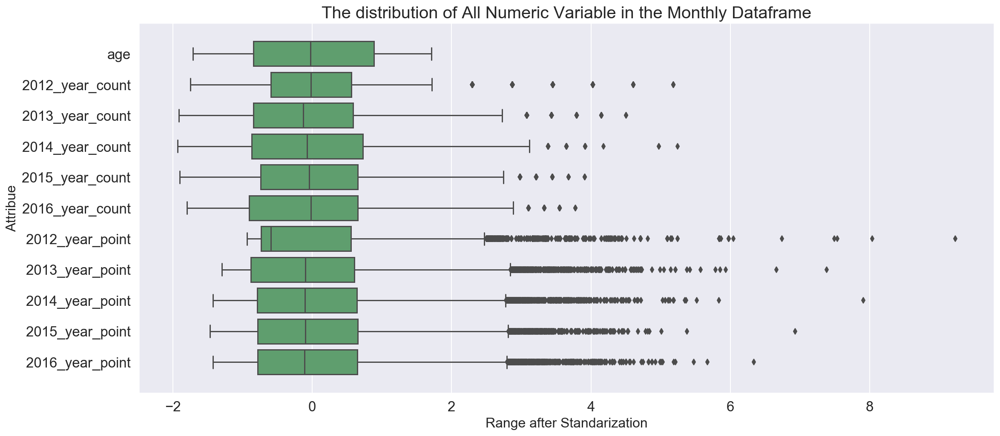

In [192]:
ax, fig = plt.subplots(1, 1, figsize = (18, 8))
plt.title('The distribution of All Numeric Variable in the Monthly Dataframe', fontsize = 20) #Change please

sns.boxplot(y = "variable", x = "value", data = pd.melt(to_standard(month_df)), color= 'g')
plt.xlabel('Range after Standarization', size = 16)
plt.ylabel('Attribue', size = 16)


# fix for mpl bug that cuts off top/bottom of seaborn viz
b, t = plt.ylim() # discover the values for bottom and top
b += 0.5 # Add 0.5 to the bottom
t -= 0.5 # Subtract 0.5 from the top
plt.ylim(b, t) # update the ylim(bottom, top) values

plt.show()

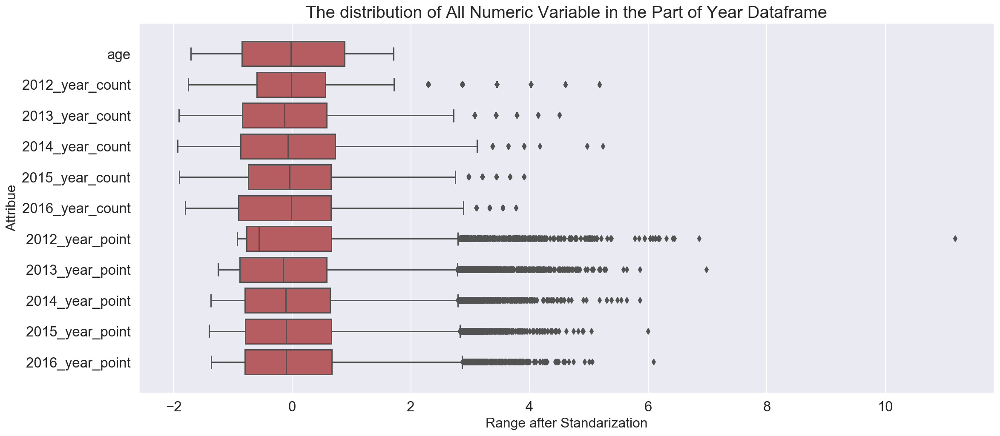

In [193]:
ax, fig = plt.subplots(1, 1, figsize = (18, 8))
plt.title('The distribution of All Numeric Variable in the Part of Year Dataframe', fontsize = 20) #Change please

sns.boxplot(y = "variable", x = "value", data = pd.melt(to_standard(poy_df)), color= 'r')
plt.xlabel('Range after Standarization', size = 16)
plt.ylabel('Attribue', size = 16)


# fix for mpl bug that cuts off top/bottom of seaborn viz
b, t = plt.ylim() # discover the values for bottom and top
b += 0.5 # Add 0.5 to the bottom
t -= 0.5 # Subtract 0.5 from the top
plt.ylim(b, t) # update the ylim(bottom, top) values

plt.show()

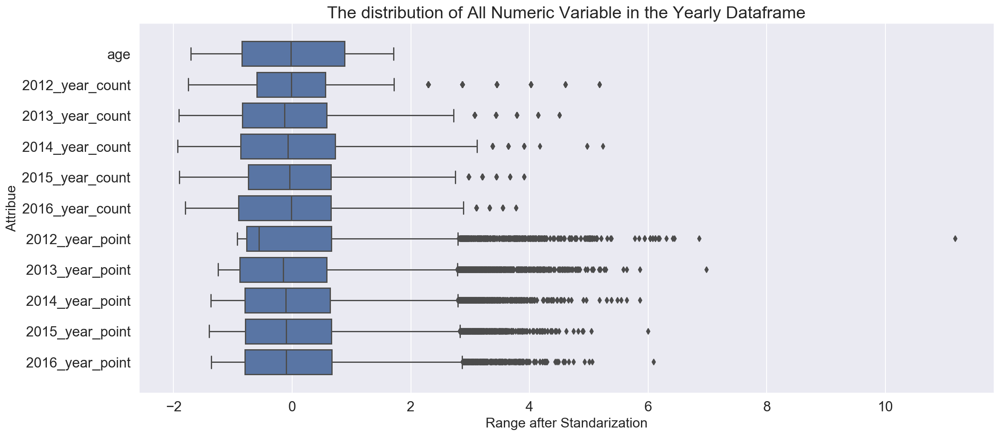

In [194]:
ax, fig = plt.subplots(1, 1, figsize = (18, 8))
plt.title('The distribution of All Numeric Variable in the Yearly Dataframe', fontsize = 20) #Change please

sns.boxplot(y = "variable", x = "value", data = pd.melt(to_standard(poy_df)), color= 'b')
plt.xlabel('Range after Standarization', size = 16)
plt.ylabel('Attribue', size = 16)


# fix for mpl bug that cuts off top/bottom of seaborn viz
b, t = plt.ylim() # discover the values for bottom and top
b += 0.5 # Add 0.5 to the bottom
t -= 0.5 # Subtract 0.5 from the top
plt.ylim(b, t) # update the ylim(bottom, top) values

plt.show()

- #### Checking skewness of numirical attributes

Most attributes in all the datasets are highly skewed.

In [197]:
numeric_feats = month_df.dtypes[month_df.dtypes != "object"].index

# Check the skew of all numerical features
skewed_feats = month_df[numeric_feats.tolist()].apply(lambda x:stats.skew(x.dropna())).sort_values(ascending = False)
print("\nSkewness in numerical features in monthly dataset: \n")
skewness = pd.DataFrame({'Skew':skewed_feats})
skewness.head(10)


Skew in numerical features in monthly dataset: 



,Skew
2012_year_point,1.460476
2013_year_point,0.832756
2014_year_point,0.692502
2016_year_point,0.654740
2015_year_point,0.609899
2012_year_count,0.573034
2013_year_count,0.491822
2014_year_count,0.434492
2015_year_count,0.378837
2016_year_count,0.377559


In [199]:
numeric_feats = poy_df.dtypes[month_df.dtypes != "object"].index

# Check the skew of all numerical features
skewed_feats = poy_df[numeric_feats.tolist()].apply(lambda x:stats.skew(x.dropna())).sort_values(ascending = False)
print("\nSkewness in numerical features in part of year dataset: \n")
skewness = pd.DataFrame({'Skew':skewed_feats})
skewness.head(10)


Skewness in numerical features in part of year dataset: 



,Skew
2012_year_point,1.430920
2013_year_point,0.934387
2014_year_point,0.738279
2015_year_point,0.651871
2016_year_point,0.648383
2012_year_count,0.573034
2013_year_count,0.491822
2014_year_count,0.434492
2015_year_count,0.378837
2016_year_count,0.377559


In [200]:
numeric_feats = year_df.dtypes[month_df.dtypes != "object"].index

# Check the skew of all numerical features
skewed_feats = year_df[numeric_feats.tolist()].apply(lambda x:stats.skew(x.dropna())).sort_values(ascending = False)
print("\nSkewness in numerical features in yearly dataset: \n")
skewness = pd.DataFrame({'Skew':skewed_feats})
skewness.head(10)


Skewness in numerical features in yearly dataset: 



,Skew
2012_year_point,1.285612
2013_year_point,0.859732
2014_year_point,0.689803
2016_year_point,0.612387
2015_year_point,0.605222
2012_year_count,0.573034
2013_year_count,0.491822
2014_year_count,0.434492
2015_year_count,0.378837
2016_year_count,0.377559


- #### Visualization of accident and violation points, count and yearly risk

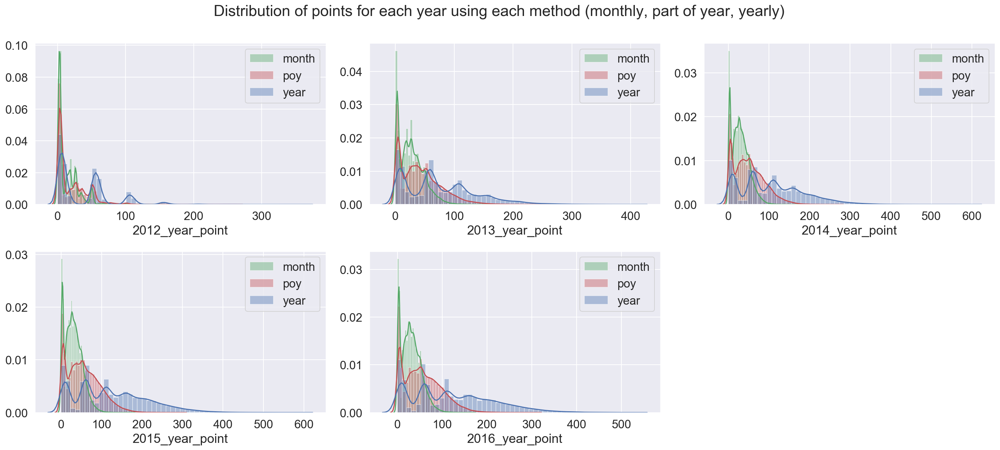

In [150]:
fig = plt.figure(figsize = (20, 25))
j = 0
point_cols = [col for col in year_df.columns if 'point' in col]

for i in year_df[point_cols].columns:
    plt.subplot(6, 3, j+1)
    j += 1
    sns.distplot(month_df[i], color='g', label = 'month')
    sns.distplot(poy_df[i], color='r', label = 'poy')
    sns.distplot(year_df[i], color='b', label = 'year')
    plt.legend(loc='best')
fig.suptitle('Distribution of points for each year using each method (monthly, part of year, yearly)')
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

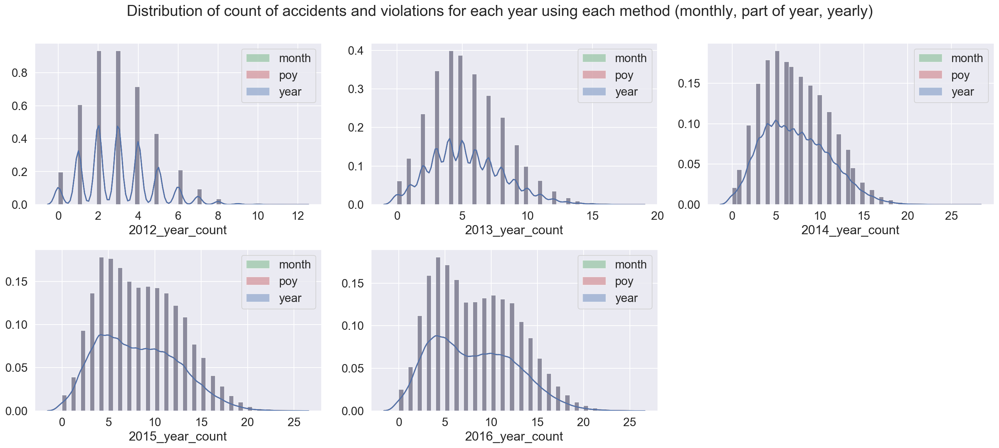

In [151]:
fig = plt.figure(figsize = (20, 25))
j = 0
count_cols = [col for col in year_df.columns if 'count' in col]

for i in year_df[count_cols].columns:
    plt.subplot(6, 3, j+1)
    j += 1
    sns.distplot(month_df[i], color='g', label = 'month')
    sns.distplot(poy_df[i], color='r', label = 'poy')
    sns.distplot(year_df[i], color='b', label = 'year')
    plt.legend(loc='best')
fig.suptitle('Distribution of count of accidents and violations for each year using each method (monthly, part of year, yearly)')
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

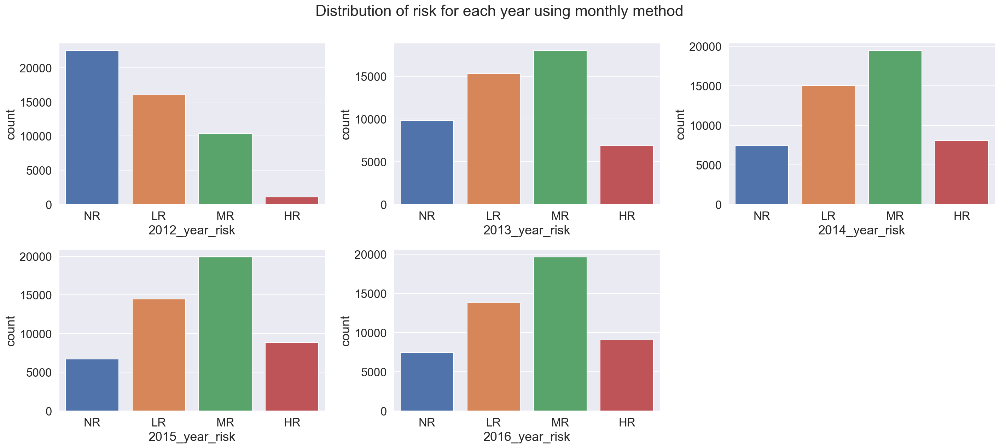

In [169]:
fig = plt.figure(figsize = (20, 25))
j = 0
risk_cols = [col for col in month_df.columns if 'risk' in col]

for i in month_df[risk_cols].columns:
    plt.subplot(6, 3, j+1)
    j += 1
    sns.countplot(x=i,data = month_df , saturation=0.90, order=['NR', 'LR','MR', 'HR'])
    
fig.suptitle('Distribution of risk for each year using monthly method')
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

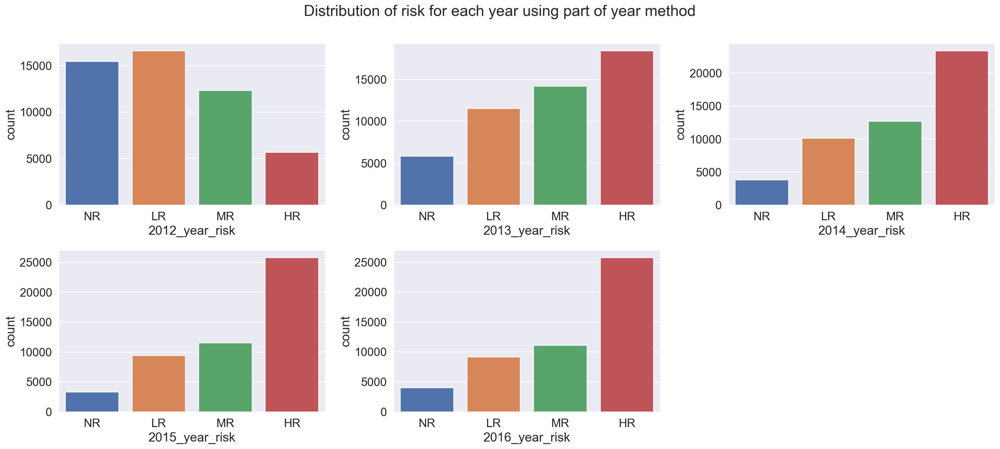

In [170]:
fig = plt.figure(figsize = (20, 25))
j = 0
risk_cols = [col for col in poy_df.columns if 'risk' in col]

for i in poy_df[risk_cols].columns:
    plt.subplot(6, 3, j+1)
    j += 1
    sns.countplot(x=i ,data = poy_df , saturation=0.90, order=['NR', 'LR','MR', 'HR'])
    
fig.suptitle('Distribution of risk for each year using part of year method')
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

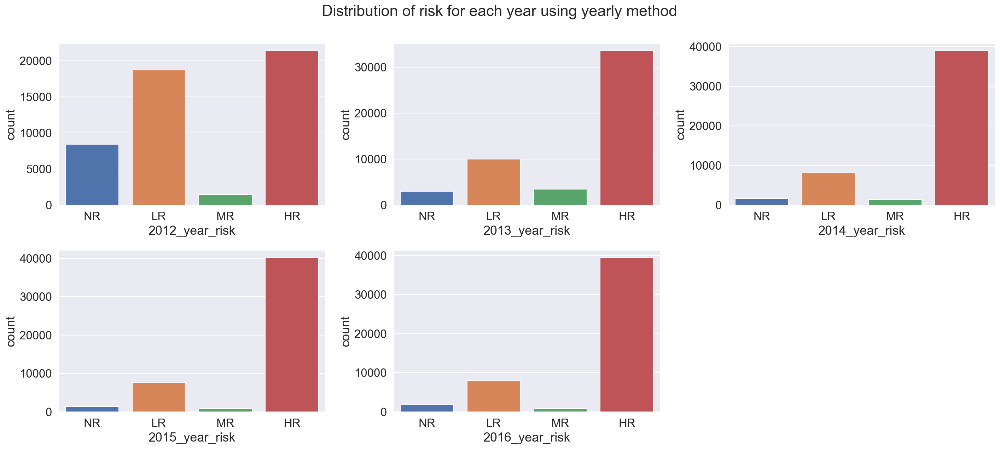

In [171]:
fig = plt.figure(figsize = (20, 25))
j = 0
risk_cols = [col for col in year_df.columns if 'risk' in col]

for i in year_df[risk_cols].columns:
    plt.subplot(6, 3, j+1)
    j += 1
    sns.countplot(x=i ,data = year_df , saturation=0.90, order=['NR', 'LR','MR', 'HR'])
    
fig.suptitle('Distribution of risk for each year using yearly method')
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

####  Distribution of points in the monthly dataset

<Figure size 432x288 with 0 Axes>

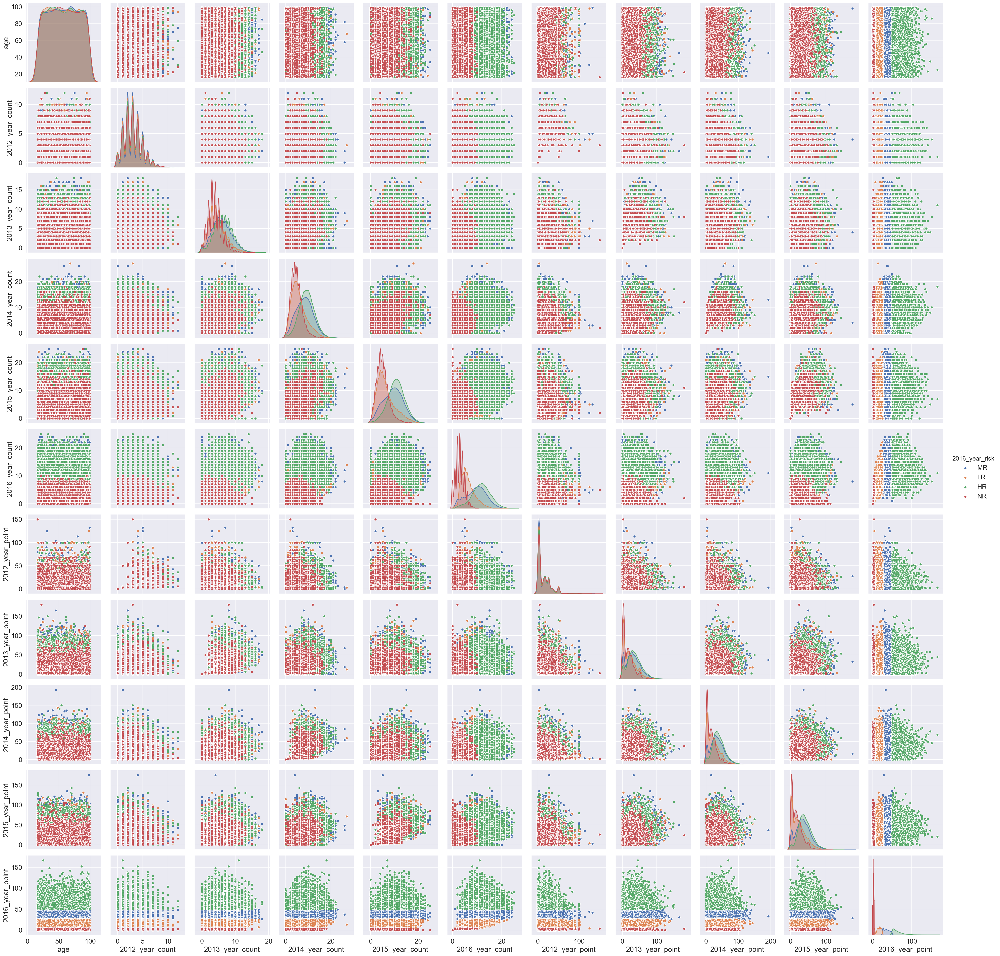

In [104]:
sns.pairplot(month_df, hue=target, height=3);
plt.show()

#### Distribution of points in the part of year dataset

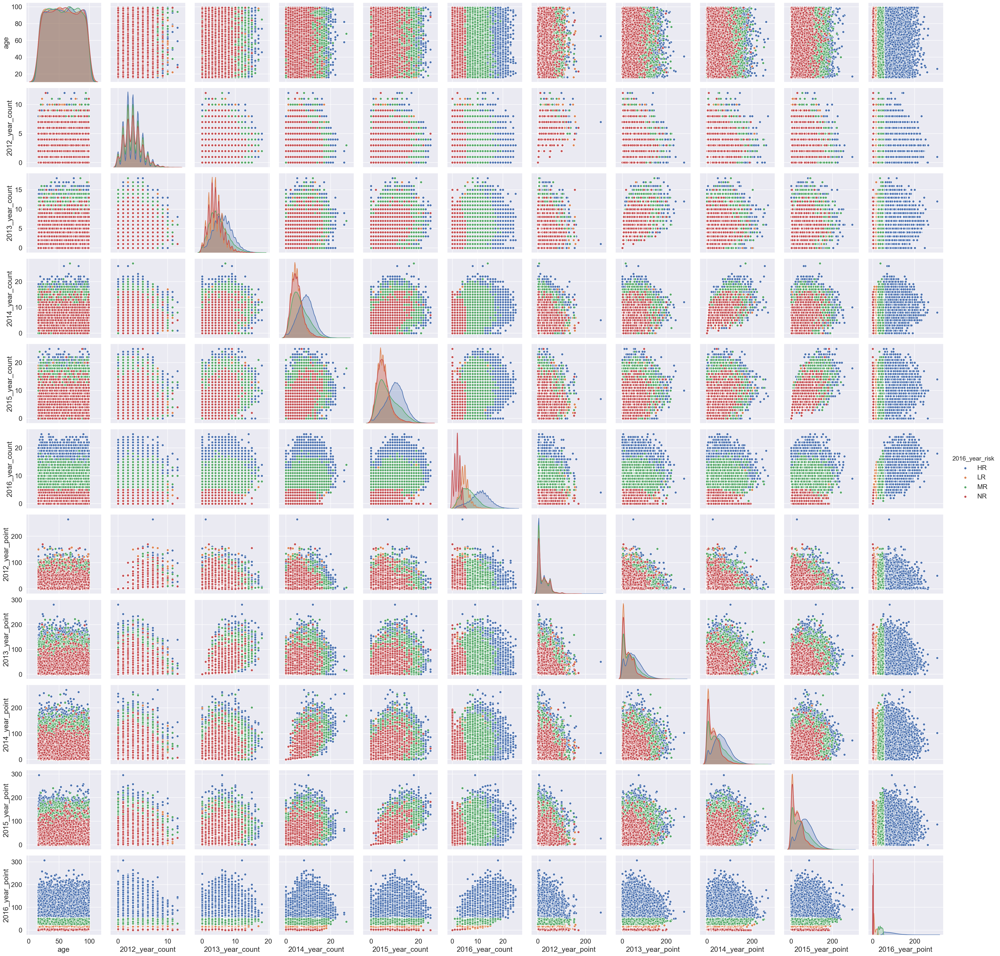

In [102]:
sns.pairplot(poy_df, hue=target, height=3);
plt.show()

#### Distribution of points in the yearly dataset

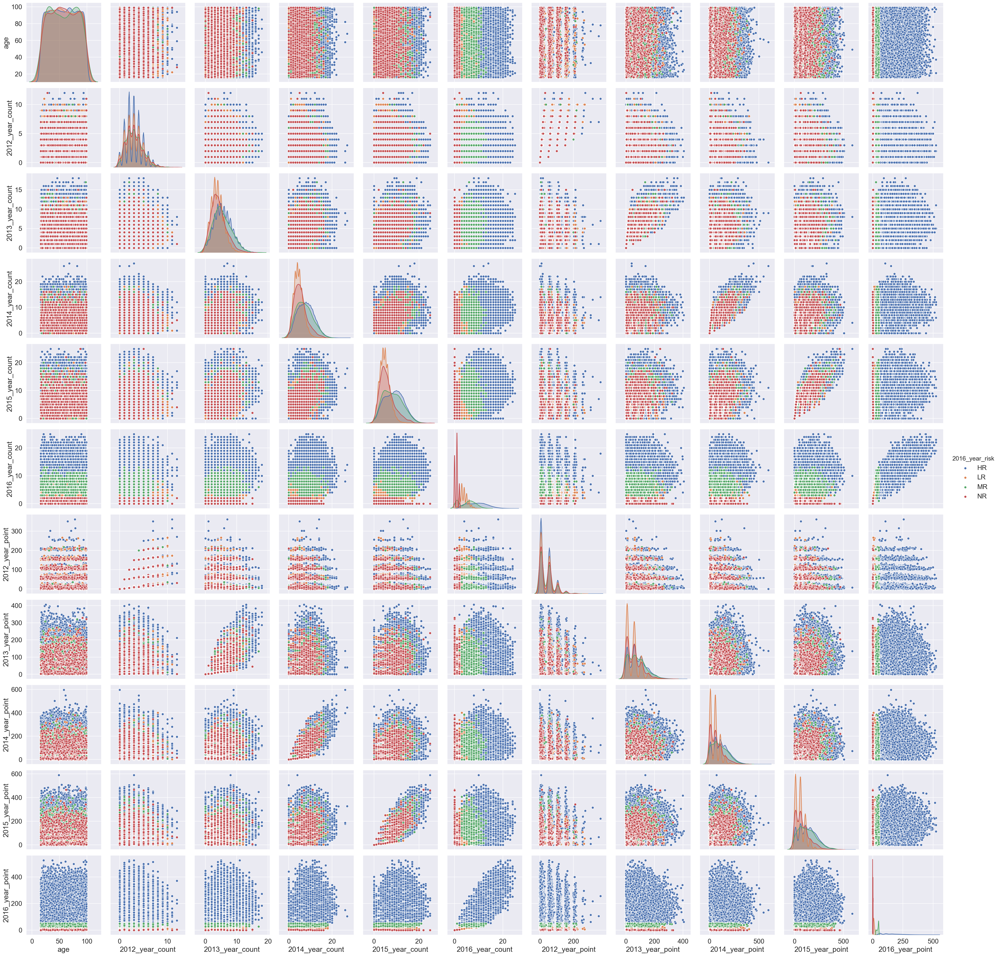

In [103]:
sns.pairplot(year_df, hue=target, height=3);
plt.show()

- #### Correlation between year points and other attributes

In [175]:
Corr_month = month_df.corr()['2016_year_point'].sort_values(ascending = False)
print("Correlation between the Attributes and points: \n")
Corr_df = pd.DataFrame({'Correlation':Corr_month})
Corr_df.head(10)

Correlation between the Attributes and points: 



,Correlation
2016_year_point,1.000000
2016_year_count,0.619538
2015_year_count,0.464170
2014_year_count,0.427857
2015_year_point,0.406553
2014_year_point,0.381356
2013_year_point,0.324955
2013_year_count,0.312204
2012_year_count,0.003699
age,-0.000034


In [176]:
Corr_poy = poy_df.corr()['2016_year_point'].sort_values(ascending = False)
print("Correlation between the Attributes and points: \n")
Corr_df = pd.DataFrame({'Correlation':Corr_poy})
Corr_df.head(10)

Correlation between the Attributes and points: 



,Correlation
2016_year_point,1.000000
2016_year_count,0.754382
2015_year_count,0.485615
2014_year_count,0.447052
2015_year_point,0.430957
2014_year_point,0.401251
2013_year_count,0.327190
2013_year_point,0.326769
age,0.003241
2012_year_count,0.002283


In [177]:
Corr_year = year_df.corr()['2016_year_point'].sort_values(ascending = False)
print("Correlation between the Attributes and points: \n")
Corr_df = pd.DataFrame({'Correlation':Corr_year})
Corr_df.head(10)

Correlation between the Attributes and points: 



,Correlation
2016_year_point,1.000000
2016_year_count,0.851106
2015_year_count,0.508476
2014_year_count,0.467140
2015_year_point,0.465209
2014_year_point,0.428379
2013_year_count,0.342851
2013_year_point,0.304267
age,0.005806
2012_year_count,0.003427


<a name="Preprocessing_and_Modeling"></a>
## Preprocessing and Modeling

In [105]:
target = '2016_year_risk'
BOLD = '\033[1m'
END = '\033[0m'
# using a stratfied k fold because we need the distribution of the to classes in all of the folds to be the same.
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

In [33]:
print(BOLD+'Monthly Baseline accuracy:'+END)
print(month_df[target].value_counts()/month_df[target].count());print()

print(BOLD+'Part of year Baseline accuracy:'+END )
print(poy_df[target].value_counts()/poy_df[target].count());print()

print(BOLD+'Yearly Baseline accuracy:'+END )
print(year_df[target].value_counts()/year_df[target].count())

Monthly Baseline accuracy:
MR    0.393062
LR    0.276212
HR    0.180927
NR    0.149799
Name: 2016_year_risk, dtype: float64

Part of year Baseline accuracy:
HR    0.515254
MR    0.221758
LR    0.182968
NR    0.080021
Name: 2016_year_risk, dtype: float64

Yearly Baseline accuracy:
HR    0.789725
LR    0.158521
NR    0.036289
MR    0.015464
Name: 2016_year_risk, dtype: float64


In [129]:
def model_metrics(model, kfold, X_train, X_test, y_train, y_test):
    
    model.fit(X_train, y_train)

    #metrics
    results = cross_val_score(model, X_train, y_train, cv = kfold)
    print("CV scores: ", results); print("CV Standard Deviation: ", results.std()); print();
    print('CV Mean score: ', results.mean()); 
    print('Train score:   ', model.score(X_train, y_train))
    print('Test score:    ', model.score(X_test, y_test))
    
    pred = model.predict(X_test)
    # CODE HERE PLEASE
    print()
    print('Confusion Matrix: ')
    print(confusion_matrix(y_test, pred))
    print('Classification Report:  ')
    print(classification_report(y_test, pred))
    train_score =  model.score(X_train, y_train)
    test_score = model.score(X_test, y_test)
    test_pred = model.predict(X_test)
    f1= f1_score(y_test, pred, average='weighted')
    
    return test_pred, test_score, results.mean(), f1

In [141]:
def basic_classifiers (X_train, X_test, y_train, y_test, kfold):
    BOLD = '\033[1m'
    END = '\033[0m'
    
    # Scaling 
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    
    ######################################################################################################  K Neighbors Classifier model
    
    print(); print(BOLD + 'K Neighbors Classifier Model:' + END)
    knn= KNeighborsClassifier()
    knn_pred, knn_test, knn_train, knn_f1 = model_metrics(knn, kfold, X_train, X_test, y_train, y_test)
    
    ###################################################################################################### Logistic Regression
    
    print(); print(BOLD + 'Logistic Regression Model:' + END)
    logistic_regression = LogisticRegression(random_state=42)
    lg_pred, lg_test, lg_train, lg_f1 = model_metrics(logistic_regression, kfold, X_train, X_test, y_train, y_test)
    
    ###################################################################################################### Decision Tree
    
    print(); print(BOLD + 'Decision Tree Classifier Model:' + END)
    decision_tree = DecisionTreeClassifier(random_state=42)
    dt_pred, dt_test, dt_train, dt_f1 = model_metrics(decision_tree, kfold, X_train, X_test, y_train, y_test)
    
    ###################################################################################################### Random Forest Classifier
    
    print(); print(BOLD + 'Random Forest Classifier Model:' + END)
    random_forest = RandomForestClassifier(random_state=42)
    rf_pred, rf_test, rf_train, rf_f1 = model_metrics(random_forest, kfold, X_train, X_test, y_train, y_test)
    
    ###################################################################################################### Extra Trees Classifier
   
    print(); print(BOLD + 'Extra Trees Classifier Model:' + END)
    extra_trees = ExtraTreesClassifier(random_state=42)
    et_pred, et_test, et_train, et_f1 = model_metrics(extra_trees, kfold, X_train, X_test, y_train, y_test)
    
    ###################################################################################################### AdaBoost Classifier
    
    print(); print(BOLD + 'AdaBoost Classifier Model:' + END)
    ada_boost = AdaBoostClassifier(random_state=42)
    ab_pred, ab_test, ab_train, ab_f1 = model_metrics(ada_boost, kfold, X_train, X_test, y_train, y_test)
    
    ###################################################################################################### SVC Classifier
    
    print(); print(BOLD + 'SVC Classifier Model:' + END)
    svc = SVC(random_state=42)
    svc_pred, svc_test, svc_train, svc_f1 = model_metrics(svc, kfold, X_train, X_test, y_train, y_test)

    fig, (ax1, ax2) = plt.subplots(ncols=2, nrows=1, figsize=(15,6))

    
    #bar chart of accuracy scores
    inds = range(1,8)
    labels = ["KNN", "Logistic Regression", "Decision Tree", "Random Forest",'Extra Trees', 'AdaBoost', 'SVC' ]
    scores_all = [knn_train, lg_train, dt_train, rf_train, et_train, ab_train, svc_train]
    scores_predictive = [knn_test, lg_test, dt_test, rf_test, et_test, ab_test, svc_test]
    
    ax1.bar(inds, scores_all, color=sns.color_palette(color)[5], alpha=0.3, hatch="x", edgecolor="none",label="CrossValidation Set")
    ax1.bar(inds, scores_predictive, color=sns.color_palette(color)[0], label="Testing set")
    ax1.set_ylim(0.2, 0.9)
    ax1.set_ylabel("Accuracy score")
    ax1.axhline(0.39, color="black", linestyle="--")
    ax1.set_title("Accuracy scores for basic models", fontsize=17)
    ax1.set_xticks(range(1,8))
    ax1.set_xticklabels(labels, size=12, rotation=40, ha="right")
    ax1.legend()

    #bar chart of accuracy scores
    f1_all = [knn_f1, lg_f1, dt_f1, rf_f1, et_f1, ab_f1, svc_f1]
    
    ax2.bar(inds, f1_all, color=sns.color_palette(color)[0], hatch="x", edgecolor="none",label="F1 scores")
    ax2.set_ylim(0.2, 0.9)
    ax2.set_ylabel("F1 score")
    #ax2.axhline(0.39, color="black", linestyle="--")
    ax2.set_title("F1 scores for basic models", fontsize=17)
    ax2.set_xticks(range(1,8))
    ax2.set_xticklabels(labels, size=12, rotation=40, ha="right")
    ax2.legend()

    plt.show()

  * ### Monthly Method ( Dividing the year to 12 months):

In [135]:
categorical_columns = month_df.select_dtypes(include=['object']).columns.tolist()
unwanted_columns = ['driverid','vehicle', 'vehicle_number','make','model','year','color',target ]
categorical_columns = [ele for ele in categorical_columns if ele not in unwanted_columns] 


K Neighbors Classifier Model:
CV scores:  [0.38349007 0.38996715 0.38489101 0.38668259 0.38518961]
CV Standard Deviation:  0.002208205023220501

CV Mean score:  0.38604408808381174
Train score:    0.5842166552208056
Test score:     0.389488360814743

Confusion Matrix: 
[[ 929  483 1510   63]
 [ 505 2119 1391  541]
 [1601 1582 2980  321]
 [ 117 1380  577  397]]
Classification Report:  
              precision    recall  f1-score   support

          HR       0.29      0.31      0.30      2985
          LR       0.38      0.47      0.42      4556
          MR       0.46      0.46      0.46      6484
          NR       0.30      0.16      0.21      2471

    accuracy                           0.39     16496
   macro avg       0.36      0.35      0.35     16496
weighted avg       0.38      0.39      0.38     16496


Logistic Regression Model:
CV scores:  [0.4766383  0.46700508 0.47820245 0.48148701 0.47446999]
CV Standard Deviation:  0.004850764354971019

CV Mean score:  0.475560566189781

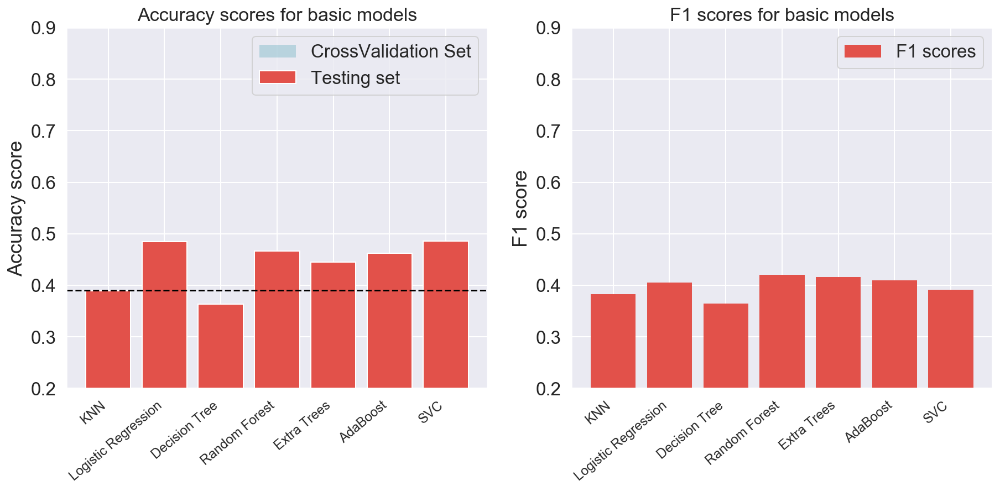

In [142]:
# Getting dummies for all categorical columns
dummies_month_df = pd.get_dummies(month_df.drop(unwanted_columns,axis=1 ), columns= categorical_columns)
dummies_month_df.dropna(inplace = True)
dummies_month_df=dummies_month_df.drop([col for col in dummies_month_df.columns if '2016' in col], axis=1)

# data splitting
X = dummies_month_df
y = month_df[target]
# using stratify for y because we need the distribution of the two classes to be equal in train and test sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify= y)

basic_classifiers( X_train, X_test, y_train, y_test, kfold)

* ### Part of year method ( dividing the year to 3 parts):


K Neighbors Classifier Model:
CV scores:  [0.53291536 0.53613019 0.53224843 0.53568229 0.5437444 ]
CV Standard Deviation:  0.0040884966465532255

CV Mean score:  0.5361441351041952
Train score:    0.659819055865755
Test score:     0.5402521823472357

Confusion Matrix: 
[[7107  674  634   85]
 [ 988 1203  676  151]
 [2063  951  552   92]
 [ 508  501  261   50]]
Classification Report:  
              precision    recall  f1-score   support

          HR       0.67      0.84      0.74      8500
          LR       0.36      0.40      0.38      3018
          MR       0.26      0.15      0.19      3658
          NR       0.13      0.04      0.06      1320

    accuracy                           0.54     16496
   macro avg       0.35      0.36      0.34     16496
weighted avg       0.48      0.54      0.50     16496


Logistic Regression Model:
CV scores:  [0.58486341 0.58136757 0.58017319 0.57629143 0.58719021]
CV Standard Deviation:  0.003780469381874384

CV Mean score:  0.581977161438863

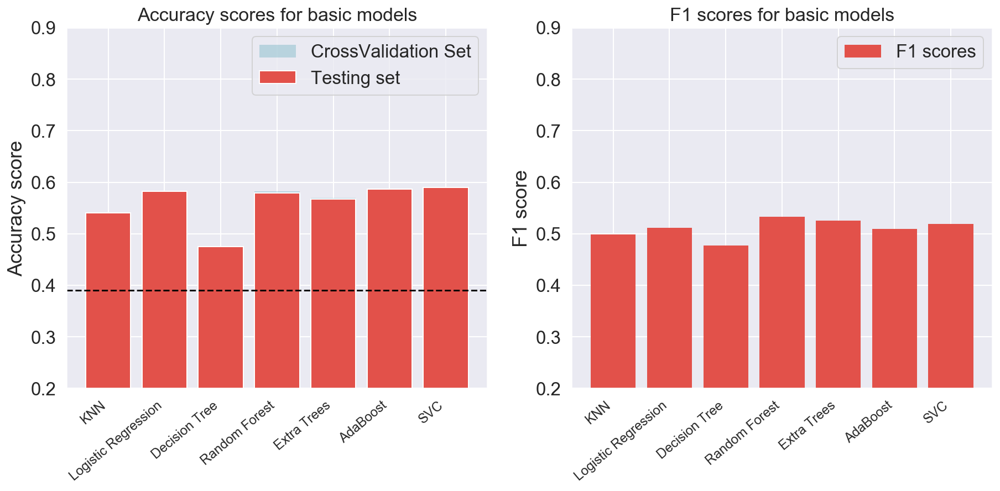

In [143]:
# Getting dummies for all categorical columns
dummies_poy_df = pd.get_dummies(poy_df.drop(unwanted_columns,axis=1 ), columns= categorical_columns, dummy_na=True)
dummies_poy_df.dropna(inplace = True)
dummies_poy_df=dummies_poy_df.drop([col for col in dummies_poy_df.columns if '2016' in col], axis=1)

# data splitting
X = dummies_poy_df
y = poy_df[target]
# using stratify for y because we need the distribution of the two classes to be equal in train and test sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify= y)

basic_classifiers( X_train, X_test, y_train, y_test, kfold)

  * ### Yearly method ( getting the points for the full year without dividing it):


K Neighbors Classifier Model:
CV scores:  [0.80758322 0.81143625 0.80412063 0.80830099 0.81218274]
CV Standard Deviation:  0.002897947203485686

CV Mean score:  0.808724766102676
Train score:    0.8661730017019498
Test score:     0.809590203685742

Confusion Matrix: 
[[12318   690     3     8]
 [ 1545  1020     1    16]
 [  227    39     0     1]
 [  361   249     1    17]]
Classification Report:  
              precision    recall  f1-score   support

          HR       0.85      0.95      0.90     13019
          LR       0.51      0.40      0.45      2582
          MR       0.00      0.00      0.00       267
          NR       0.40      0.03      0.05       628

    accuracy                           0.81     16496
   macro avg       0.44      0.34      0.35     16496
weighted avg       0.77      0.81      0.78     16496


Logistic Regression Model:
CV scores:  [0.97835498 0.9823828  0.98312929 0.9820842  0.98178561]
CV Standard Deviation:  0.001657512323870688

CV Mean score:  0.9

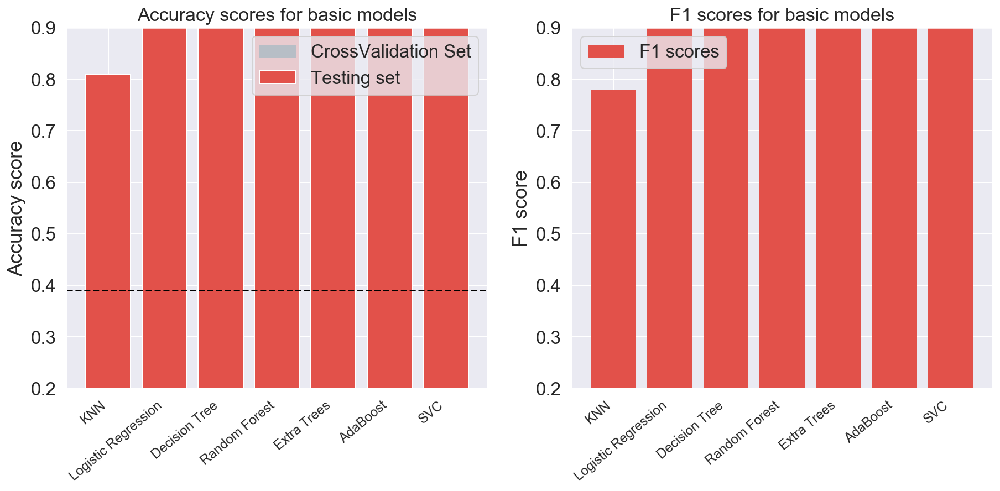

In [144]:
# Getting dummies for all categorical columns
dummies_year_df = pd.get_dummies(year_df.drop(unwanted_columns,axis=1 ), columns= categorical_columns, dummy_na=True)
dummies_year_df.dropna(inplace = True)

# data splitting
X = dummies_year_df
y = year_df[target]
# using stratify for y because we need the distribution of the two classes to be equal in train and test sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

basic_classifiers( X_train, X_test, y_train, y_test, kfold)

<a name="Conclusions_and_Recommendations"></a>
## Conclusions and Recommendations

For the monthly dataset, the model with highest predictive score was Logistic Regression Model with an accuracy of 0.47 with the 5-fold cross validation compared to its baseline accuracy of 0.39.

For the part of year dataset, the model with highest predictive score was Ada Boost Model with an accuracy of 0.585 with the 5-fold cross validation compared to its baseline accuracy of 0.515.

For the yearly dataset, All the models had very high accuracy but very bad score for the medium risk class, as the 4 classes were not balanced with 78.9% of the dataset were classified as high risk.

The dataset was generated and the count and points were randomly assigned to each driver, so there was no significant natural trends to learn from and train on to produce predictions that are highly accurate.